Code partagé par M. Florian Cafiero dans le cadre du cours "Des chiffres et des lettres : l'analyse computationnelle du langage au service de l'étude des textes" (ENS PSL 2024)

# Vocabulaire annoté par crowdsourcing: analyse avec NRClex

In [3]:
!pip install nrclex

INFO: pip is looking at multiple versions of nrclex to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 396.4/396.4 kB 7.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for nrclex: filename=NRCLex-3.0.0-py3-none-any.whl size=43309 sha256=d1b599a412afdcac7a90ca7f5dfb5b6970acc1493b919f6a6ef0537cf0e47a11
  Stored in directory: /root/.cache/pip/wheels/d2/10/44/6abfb1234298806a145fd6bcaec8cbc712e88dd1cd6cb242fa
Successfully built nrclex


In [4]:
import sys
print(sys.version)

3.10.12 (main, Nov 20 2023, 15:14:05) [GCC 11.4.0]


In [11]:
!pip install nltk

In [5]:
from nrclex import NRCLex

import numpy as np
import pandas as pd

## Un premier exemple

In [5]:
import nltk
nltk.download('punkt')

# Le texte à annoter
text = 'Your code is absolutely horrible, Dr. Cafiero !'

# On crée l'object
emotion = NRCLex(text)

# Et on affiche les résultats
print('\n', emotion.words)
print('\n', emotion.affect_dict)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.



 ['Your', 'code', 'is', 'absolutely', 'horrible', 'Dr', 'Cafiero']

 {'horrible': ['anger', 'disgust', 'fear', 'negative']}


## Avec un brin plus de texte

In [6]:
text = 'There is a good place and a bad place.'\
        'You are in the good place.'
emotion = NRCLex(text)
print('\n', emotion.affect_dict)
print('\n', emotion.raw_emotion_scores)


 {'good': ['anticipation', 'joy', 'positive', 'surprise', 'trust'], 'bad': ['anger', 'disgust', 'fear', 'negative', 'sadness']}

 {'anticipation': 2, 'joy': 2, 'positive': 2, 'surprise': 2, 'trust': 2, 'anger': 1, 'disgust': 1, 'fear': 1, 'negative': 1, 'sadness': 1}


## Déterminer l'émotion dominante

Plutôt que d'avoir des résultats qui, avec des textes un peu long, peuvent parfois paraître confus, on peut ne s'intéresser qu'aux émotions les plus fortement repérées dans le texte.

In [7]:
print('\n', emotion.top_emotions)


 [('trust', 0.13333333333333333), ('surprise', 0.13333333333333333), ('positive', 0.13333333333333333), ('joy', 0.13333333333333333), ('anticipation', 0.13333333333333333)]


## Normaliser les émotions

On peut vouloir se représenter les émotions d'un certain passage, non pas dans l'absolu, mais relativement à la quantité d'émotions dans le passage donné. On considère que chaque passage étudié à un niveau d'émotion de 1.

In [ ]:
print('\n', emotion.affect_frequencies)


 {'fear': 0.06666666666666667, 'anger': 0.06666666666666667, 'anticip': 0.0, 'trust': 0.13333333333333333, 'surprise': 0.13333333333333333, 'positive': 0.13333333333333333, 'negative': 0.06666666666666667, 'sadness': 0.06666666666666667, 'disgust': 0.06666666666666667, 'joy': 0.13333333333333333, 'anticipation': 0.13333333333333333}


## Avec le corpus obtenu à partir de *Chronicling America* (1776-1850)

In [6]:
!pip install tabulate

In [7]:
from nrclex import NRCLex
from textblob import TextBlob
from tabulate import tabulate
import pandas as pd

print("All packages imported successfully!")

All packages imported successfully!


In [16]:
from google.colab import files

# Upload files
uploaded = files.upload()

# List of file names
txt_files = list(uploaded.keys())

Saving Alexandria advertiser and commercial intelligencer. [volume]_18020917.txt to Alexandria advertiser and commercial intelligencer. [volume]_18020917 (1).txt
Saving Alexandria advertiser and commercial intelligencer. [volume]_18020920.txt to Alexandria advertiser and commercial intelligencer. [volume]_18020920 (1).txt
Saving Alexandria daily gazette, commercial & political. [volume]_18090529.txt to Alexandria daily gazette, commercial & political. [volume]_18090529 (1).txt
Saving Alexandria gazette & daily advertiser. [volume]_18210409.txt to Alexandria gazette & daily advertiser. [volume]_18210409 (1).txt
Saving Alexandria gazette. [volume]_18381225.txt to Alexandria gazette. [volume]_18381225 (1).txt
Saving Alexandria gazette. [volume]_18440316.txt to Alexandria gazette. [volume]_18440316 (1).txt
Saving Alexandria gazette. [volume]_18451118.txt to Alexandria gazette. [volume]_18451118 (1).txt
Saving Alexandria gazette. [volume]_18451122.txt to Alexandria gazette. [volume]_1845112

In [17]:
import os
import glob
from nrclex import NRCLex
from tabulate import tabulate
import pandas as pd
import nltk
nltk.download('punkt')


# Créer une liste pour stocker les résultats
emotions_data = []

# Analyser chaque fichier
for txt_file in txt_files:
    with open(txt_file, 'r') as file:
        text = file.read()

    # Créer l'objet NRCLex
    emotion = NRCLex(text)

    # Récupérer les scores émotionnels et les stocker dans un dictionnaire
    result = {
        "file": os.path.basename(txt_file),  # Get the file name without the full path
        "emotion frequencies": emotion.affect_frequencies,
        "top_emotions": emotion.top_emotions
    }

    emotions_data.append(result)

# Convertir la liste des résultats en DataFrame pour une analyse ultérieure
df_emotions = pd.DataFrame(emotions_data)

# Afficher les résultats
print(df_emotions)

# Créer une table formatée avec tabulate
table = tabulate(df_emotions, headers='keys', tablefmt='pipe', showindex=False)

# Afficher la table
print(table)


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


                                                  file  \
0    Alexandria advertiser and commercial intellige...   
1    Alexandria advertiser and commercial intellige...   
2    Alexandria daily gazette, commercial & politic...   
3    Alexandria gazette & daily advertiser. [volume...   
4        Alexandria gazette. [volume]_18381225 (1).txt   
..                                                 ...   
121           Wheeling compiler. [volume]_18300106.txt   
122  Wheeling times and advertiser. [volume]_184001...   
123  Wheeling times and advertiser. [volume]_184105...   
124  Wheeling times and advertiser. [volume]_184606...   
125                 Wilmington expositor._18310930.txt   

                                   emotion frequencies  \
0    {'fear': 0.0972644376899696, 'anger': 0.079027...   
1    {'fear': 0.07159353348729793, 'anger': 0.08314...   
2    {'fear': 0.11219512195121951, 'anger': 0.08292...   
3    {'fear': 0.08163265306122448, 'anger': 0.06632...   
4    {'fear':

AUTRE OPTION: MONTER LE DRIVE GOOGLE

from google.colab import drive
drive.mount('/content/drive')

text_dir = '/content/drive/MyDrive/corpus17761850/'  

import glob
import os

txt_files = glob.glob(os.path.join(text_dir, "*.txt"))


### Un petit graphique pour rendre tout ça plus clair

In [15]:
import matplotlib.pyplot as plt

# Liste des émotions à comparer
emotions = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']

# Itérer sur chaque émotion pour créer un graphique à barres
for emotion in emotions:
    # Créer une liste des fréquences de l'émotion pour chaque texte
    emotion_values = [d['emotion frequencies'][emotion] for d in emotions_data]
    file_names = [os.path.basename(d['file']) for d in emotions_data]

    # Créer le graphique à barres
    plt.figure(figsize=(14, 8))  # Augmenter la taille de la figure
    plt.bar(file_names, emotion_values)
    plt.xlabel('Text Files')
    plt.ylabel('Emotion Frequency')
    plt.title(f'Comparing {emotion.capitalize()} Frequencies Across Texts')

    # Ajuster la rotation et l'alignement des étiquettes (sinon illisible)
    plt.xticks(rotation=45, ha='right', fontsize=10)  # Réduire la taille de la police des étiquettes

    # Ajouter du padding en bas (sinon illisible)
    plt.gcf().subplots_adjust(bottom=0.25)

    # Afficher le graphique
    plt.tight_layout()
    plt.show()


Output hidden; open in https://colab.research.google.com to view.

Ci-dessus, les graphiques pour la moitié du corpus (63 textes). Ci-dessous, une tentative de graphique avec les étiquettes à la verticale pour essayer de gagner de la place, sans trop de succès.

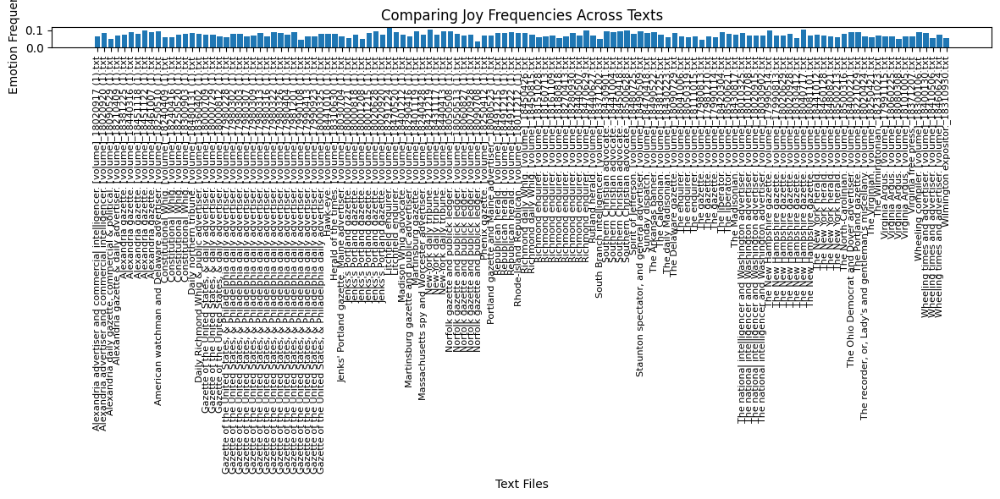

In [18]:
import matplotlib.pyplot as plt

# Liste des émotions à comparer
emotions = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']

# Itérer sur chaque émotion pour créer un graphique à barres
for emotion in emotions:
    # Créer une liste des fréquences de l'émotion pour chaque texte
    emotion_values = [d['emotion frequencies'][emotion] for d in emotions_data]
    file_names = [os.path.basename(d['file']) for d in emotions_data]

    # Créer le graphique à barres
plt.figure(figsize=(12, 6))
plt.bar(file_names, emotion_values)
plt.xlabel('Text Files')
plt.ylabel('Emotion Frequency')
plt.title(f'Comparing {emotion.capitalize()} Frequencies Across Texts')

# Ajuster la rotation et l'alignement des étiquettes
plt.xticks(rotation=90, ha='center', fontsize=8)  # Rotation verticale des étiquettes, centrage horizontal et taille de police réduite

# Afficher le graphique
plt.tight_layout()
plt.show()


In [19]:
#Avec les 126 textes du corpus:
import matplotlib.pyplot as plt

# Liste des émotions à comparer
emotions = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']

# Itérer sur chaque émotion pour créer un graphique à barres
for emotion in emotions:
    # Créer une liste des fréquences de l'émotion pour chaque texte
    emotion_values = [d['emotion frequencies'][emotion] for d in emotions_data]
    file_names = [os.path.basename(d['file']) for d in emotions_data]

    # Créer le graphique à barres
    plt.figure(figsize=(14, 8))  # Augmenter la taille de la figure
    plt.bar(file_names, emotion_values)
    plt.xlabel('Text Files')
    plt.ylabel('Emotion Frequency')
    plt.title(f'Comparing {emotion.capitalize()} Frequencies Across Texts')

    # Ajuster la rotation et l'alignement des étiquettes (sinon illisible)
    plt.xticks(rotation=45, ha='right', fontsize=10)  # Réduire la taille de la police des étiquettes

    # Ajouter du padding en bas (sinon illisible)
    plt.gcf().subplots_adjust(bottom=0.25)

    # Afficher le graphique
    plt.tight_layout()
    plt.show()


Output hidden; open in https://colab.research.google.com to view.

### Un algorithme roulant

On peut vouloir suivre l'évolution de chaque émotion dans chacun des textes du corpus. Le code suivant donne une version très maximaliste, pas forcément lisible - on peut choisir de ne visualiser que certaines des émotions plutôt que toutes, bien entendu.

In [20]:
from nrclex import NRCLex
import matplotlib.pyplot as plt
import io
from zipfile import ZipFile
from google.colab import files

# Upload files
uploaded = files.upload()

# List of file names
txt_files = list(uploaded.keys())

# Taille de la fenêtre (par exemple, 100 mots)
window_size = 100
# Pas de glissement (50% de chevauchement)
step_size = window_size // 2

# Liste des émotions à analyser
emotions = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']

emotion_colors = {
    'fear': 'red',
    'anger': 'orange',
    'anticipation': 'yellow',
    'trust': 'green',
    'surprise': 'blue',
    'positive': 'purple',
    'negative': 'brown',
    'sadness': 'gray',
    'disgust': 'pink',
    'joy': 'cyan'
}

# Analyser chaque fichier texte
for file_name in txt_files:
    with io.BytesIO(uploaded[file_name]) as f:
        text = f.read().decode()

    # Tokenisation du texte
    tokens = text.split()

    # Liste pour stocker les fréquences émotionnelles pour chaque segment
    emotion_data = []

    # Glisser la fenêtre le long du texte
    for start in range(0, len(tokens) - window_size, step_size):
        end = start + window_size
        segment = " ".join(tokens[start:end])

        # Analyse des émotions pour le segment
        emotion = NRCLex(segment)

        # Enregistrer les fréquences émotionnelles
        emotion_data.append(emotion.affect_frequencies)

    # Créer des graphiques pour chaque émotion
    plt.figure(figsize=(12, 6))
    for emotion_name in emotions:
        # Récupérer les fréquences pour chaque segment
        emotion_values = [data.get(emotion_name, 0) for data in emotion_data]

        # Tracer le graphique
        plt.plot(emotion_values, label=emotion_name.capitalize())

    # Configuration du graphique
    plt.xlabel("Segment")
    plt.ylabel("Fréquence Emotionnelle")
    plt.title(f"Évolution des Émotions - {file_name}")
    plt.legend()
    plt.tight_layout()

    # Afficher le graphique
    plt.show()


Output hidden; open in https://colab.research.google.com to view.

Saving Alexandria advertiser and commercial intelligencer. [volume]_18020917.txt to Alexandria advertiser and commercial intelligencer. [volume]_18020917 (2).txt
Saving Alexandria advertiser and commercial intelligencer. [volume]_18020920.txt to Alexandria advertiser and commercial intelligencer. [volume]_18020920 (2).txt
Saving Alexandria daily gazette, commercial & political. [volume]_18090529.txt to Alexandria daily gazette, commercial & political. [volume]_18090529 (2).txt
Saving Alexandria gazette & daily advertiser. [volume]_18210409.txt to Alexandria gazette & daily advertiser. [volume]_18210409 (2).txt
Saving Alexandria gazette. [volume]_18381225.txt to Alexandria gazette. [volume]_18381225 (2).txt
Saving Alexandria gazette. [volume]_18440316.txt to Alexandria gazette. [volume]_18440316 (2).txt
Saving Alexandria gazette. [volume]_18451118.txt to Alexandria gazette. [volume]_18451118 (2).txt
Saving Alexandria gazette. [volume]_18451122.txt to Alexandria gazette. [volume]_1845112

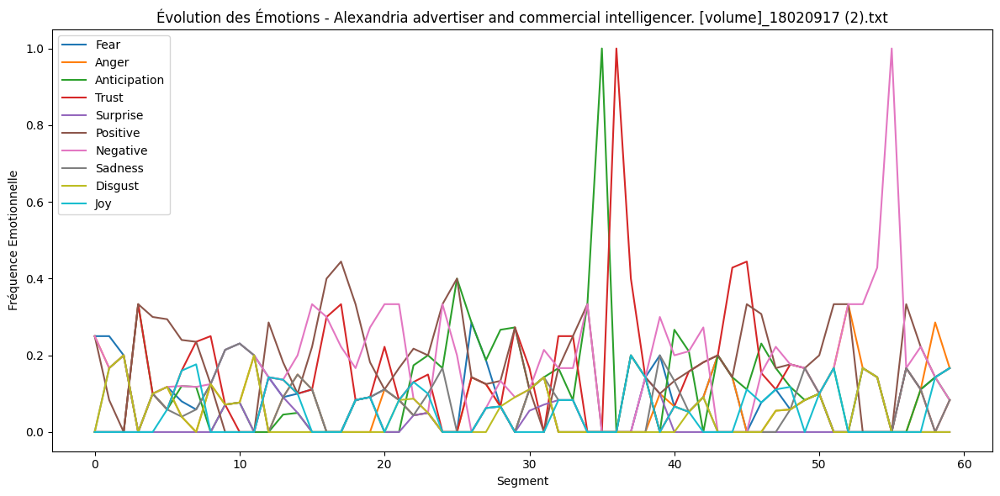

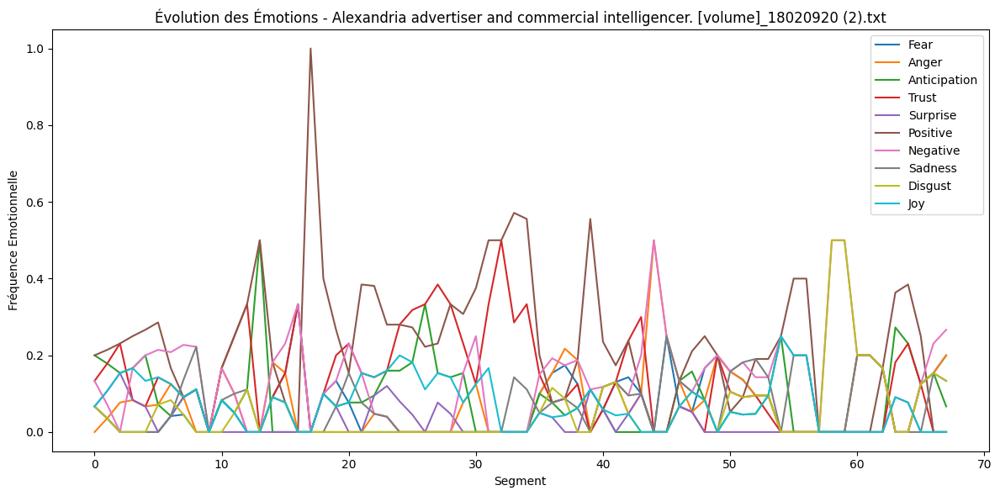

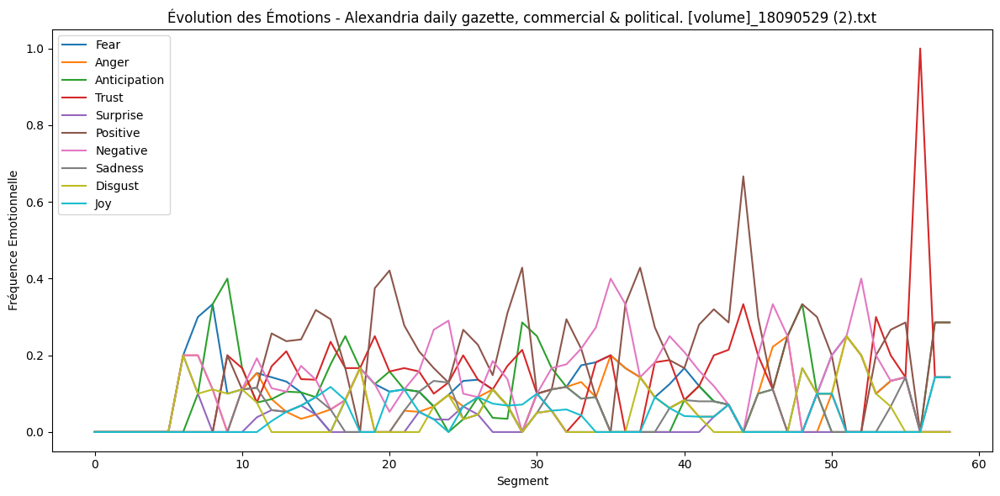

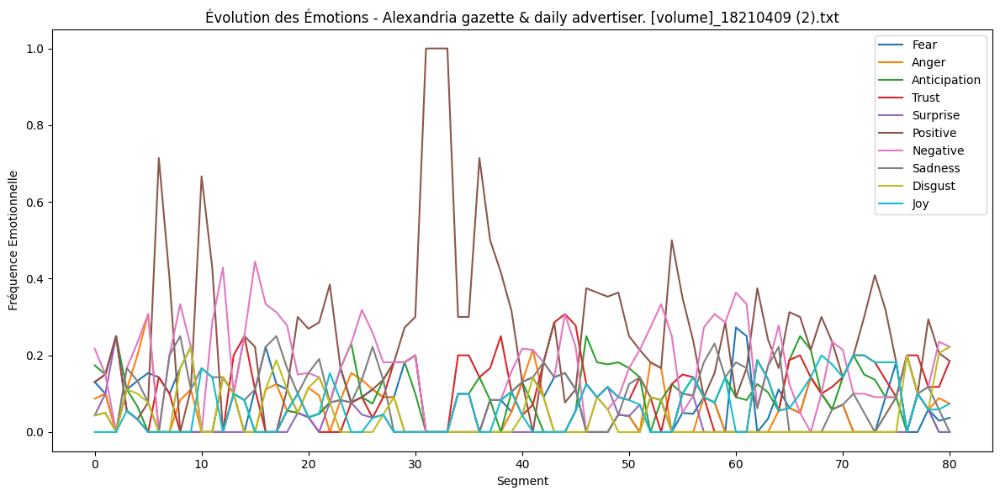

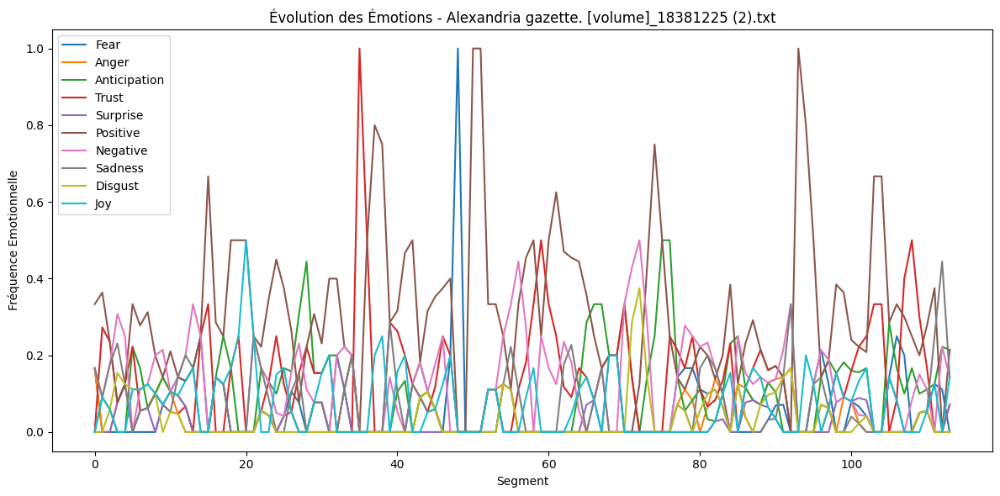

...

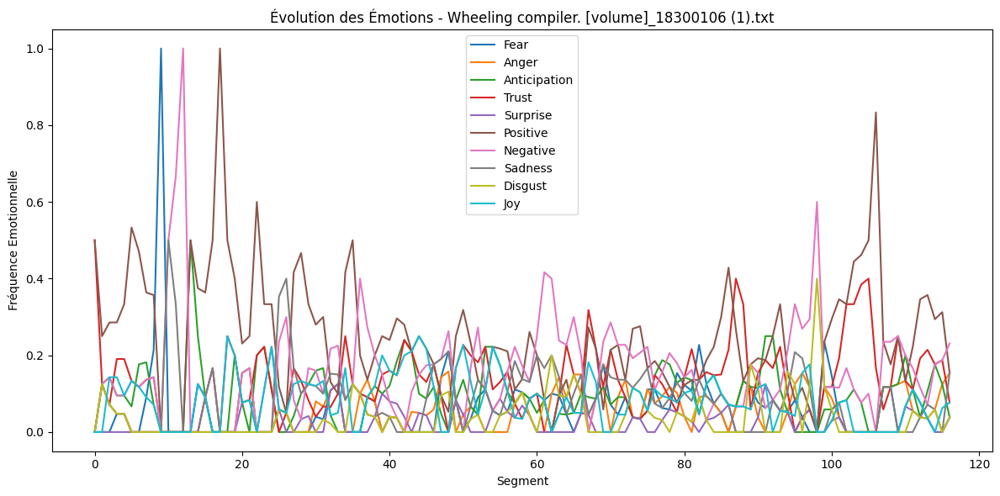

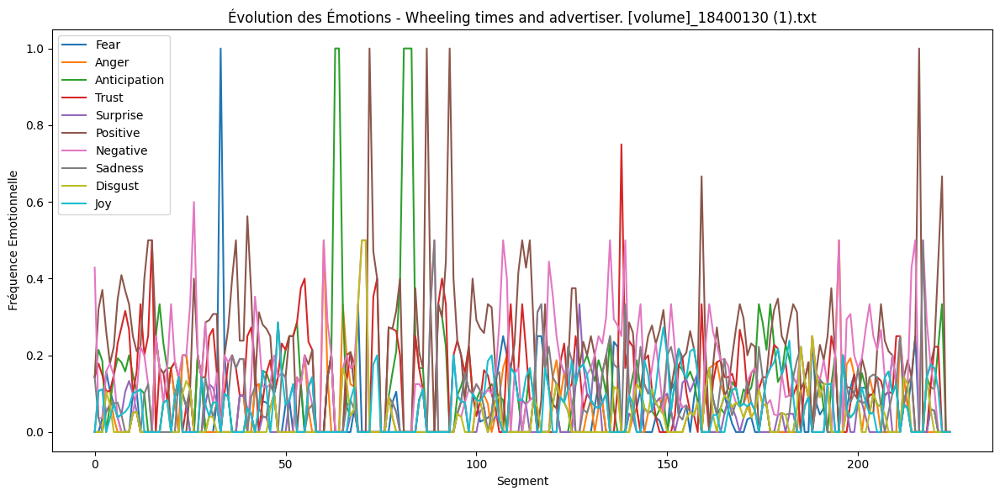

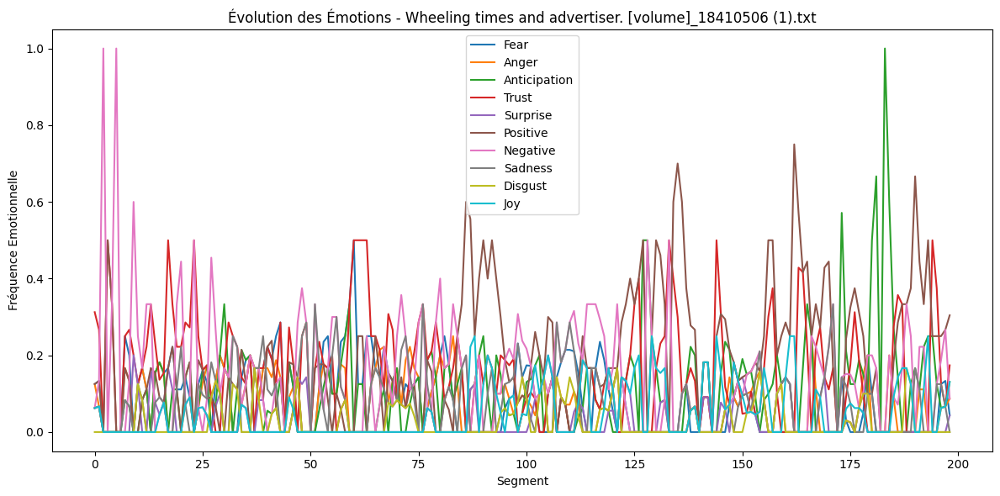

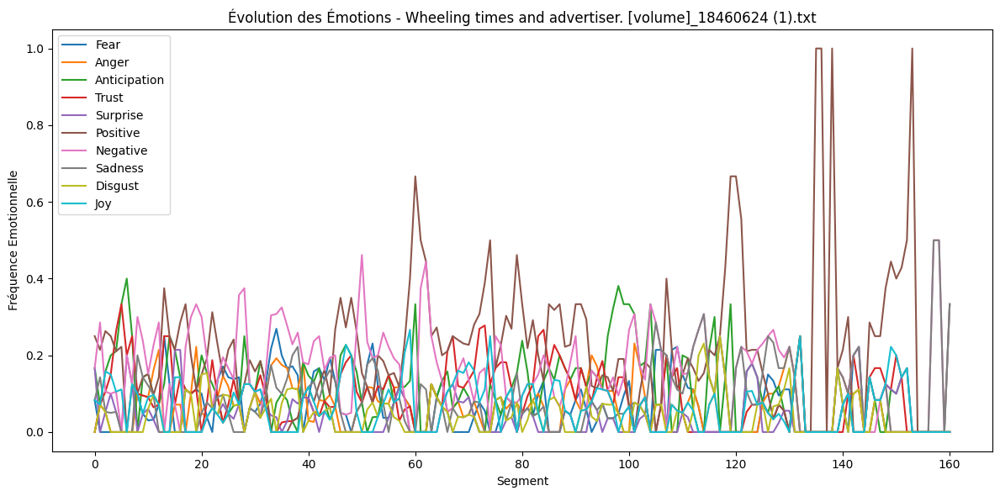

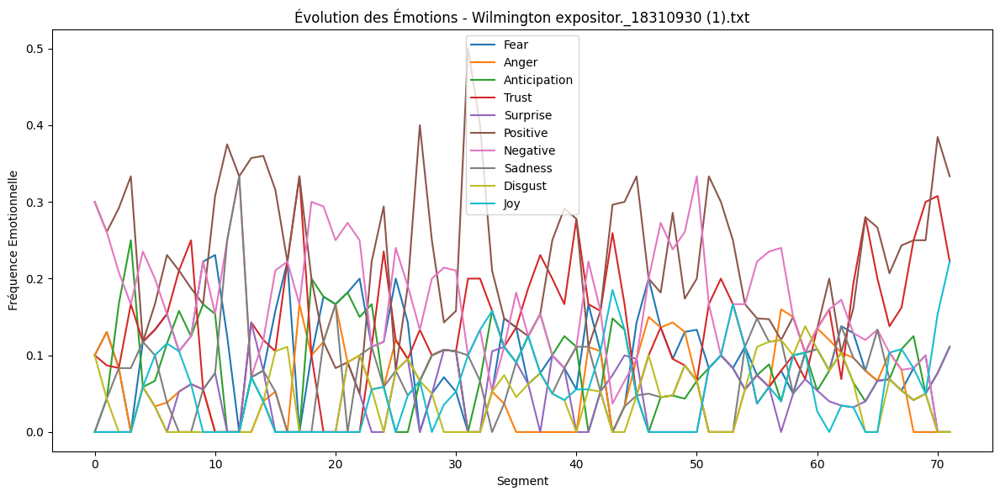

In [ ]:
from nrclex import NRCLex
import matplotlib.pyplot as plt
import io
from zipfile import ZipFile
from google.colab import files

# Upload files
uploaded = files.upload()

# List of file names
txt_files = list(uploaded.keys())

# Taille de la fenêtre (par exemple, 100 mots)
window_size = 100
# Pas de glissement (50% de chevauchement)
step_size = window_size // 2

# Liste des émotions à analyser
emotions = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']

emotion_colors = {
    'fear': 'red',
    'anger': 'orange',
    'anticipation': 'yellow',
    'trust': 'green',
    'surprise': 'blue',
    'positive': 'purple',
    'negative': 'brown',
    'sadness': 'gray',
    'disgust': 'pink',
    'joy': 'cyan'
}

# Analyser chaque fichier texte
for file_name in txt_files:
    with io.BytesIO(uploaded[file_name]) as f:
        text = f.read().decode()

    # Tokenisation du texte
    tokens = text.split()

    # Liste pour stocker les fréquences émotionnelles pour chaque segment
    emotion_data = []

    # Glisser la fenêtre le long du texte
    for start in range(0, len(tokens) - window_size, step_size):
        end = start + window_size
        segment = " ".join(tokens[start:end])

        # Analyse des émotions pour le segment
        emotion = NRCLex(segment)

        # Enregistrer les fréquences émotionnelles
        emotion_data.append(emotion.affect_frequencies)

    # Créer des graphiques pour chaque émotion
    plt.figure(figsize=(12, 6))
    for emotion_name in emotions:
        # Récupérer les fréquences pour chaque segment
        emotion_values = [data.get(emotion_name, 0) for data in emotion_data]

        # Tracer le graphique
        plt.plot(emotion_values, label=emotion_name.capitalize())

    # Configuration du graphique
    plt.xlabel("Segment")
    plt.ylabel("Fréquence Emotionnelle")
    plt.title(f"Évolution des Émotions - {file_name}")
    plt.legend()
    plt.tight_layout()

    # Afficher le graphique
    plt.show()


In [22]:
#Pour les émotions positives, {'good': ['anticipation', 'joy', 'positive', 'surprise', 'trust'], 'bad': ['anger', 'disgust', 'fear', 'negative', 'sadness']}

from nrclex import NRCLex
import matplotlib.pyplot as plt
import io
from zipfile import ZipFile
from google.colab import files

# Upload files
uploaded = files.upload()

# List of file names
txt_files = list(uploaded.keys())

# Taille de la fenêtre (par exemple, 100 mots)
window_size = 100
# Pas de glissement (50% de chevauchement)
step_size = window_size // 2

# Liste des émotions à analyser
emotions = ['anticipation', 'trust', 'surprise', 'positive', 'joy']

emotion_colors = {
    'anticipation': 'yellow',
    'trust': 'green',
    'surprise': 'blue',
    'positive': 'purple',
    'joy': 'cyan'
}

# Analyser chaque fichier texte
for file_name in txt_files:
    with io.BytesIO(uploaded[file_name]) as f:
        text = f.read().decode()

    # Tokenisation du texte
    tokens = text.split()

    # Liste pour stocker les fréquences émotionnelles pour chaque segment
    emotion_data = []

    # Glisser la fenêtre le long du texte
    for start in range(0, len(tokens) - window_size, step_size):
        end = start + window_size
        segment = " ".join(tokens[start:end])

        # Analyse des émotions pour le segment
        emotion = NRCLex(segment)

        # Enregistrer les fréquences émotionnelles
        emotion_data.append(emotion.affect_frequencies)

    # Créer des graphiques pour chaque émotion
    plt.figure(figsize=(12, 6))
    for emotion_name in emotions:
        # Récupérer les fréquences pour chaque segment
        emotion_values = [data.get(emotion_name, 0) for data in emotion_data]

        # Tracer le graphique
        plt.plot(emotion_values, label=emotion_name.capitalize())

    # Configuration du graphique
    plt.xlabel("Segment")
    plt.ylabel("Fréquence Emotionnelle")
    plt.title(f"Évolution des Émotions - {file_name}")
    plt.legend()
    plt.tight_layout()

    # Afficher le graphique
    plt.show()


Output hidden; open in https://colab.research.google.com to view.

In [23]:
#Pour les émotions négatives

from nrclex import NRCLex
import matplotlib.pyplot as plt
import io
from zipfile import ZipFile
from google.colab import files

# Upload files
uploaded = files.upload()

# List of file names
txt_files = list(uploaded.keys())

# Taille de la fenêtre (par exemple, 100 mots)
window_size = 100
# Pas de glissement (50% de chevauchement)
step_size = window_size // 2

# Liste des émotions à analyser
emotions = ['fear', 'anger','negative', 'sadness', 'disgust']

emotion_colors = {
    'fear': 'red',
    'anger': 'orange',
    'negative': 'brown',
    'sadness': 'gray',
    'disgust': 'pink',
}

# Analyser chaque fichier texte
for file_name in txt_files:
    with io.BytesIO(uploaded[file_name]) as f:
        text = f.read().decode()

    # Tokenisation du texte
    tokens = text.split()

    # Liste pour stocker les fréquences émotionnelles pour chaque segment
    emotion_data = []

    # Glisser la fenêtre le long du texte
    for start in range(0, len(tokens) - window_size, step_size):
        end = start + window_size
        segment = " ".join(tokens[start:end])

        # Analyse des émotions pour le segment
        emotion = NRCLex(segment)

        # Enregistrer les fréquences émotionnelles
        emotion_data.append(emotion.affect_frequencies)

    # Créer des graphiques pour chaque émotion
    plt.figure(figsize=(12, 6))
    for emotion_name in emotions:
        # Récupérer les fréquences pour chaque segment
        emotion_values = [data.get(emotion_name, 0) for data in emotion_data]

        # Tracer le graphique
        plt.plot(emotion_values, label=emotion_name.capitalize())

    # Configuration du graphique
    plt.xlabel("Segment")
    plt.ylabel("Fréquence Emotionnelle")
    plt.title(f"Évolution des Émotions - {file_name}")
    plt.legend()
    plt.tight_layout()

    # Afficher le graphique
    plt.show()


Output hidden; open in https://colab.research.google.com to view.

### Tentons de regrouper les textes les plus proches

#### Classification ascendante hiérarchique

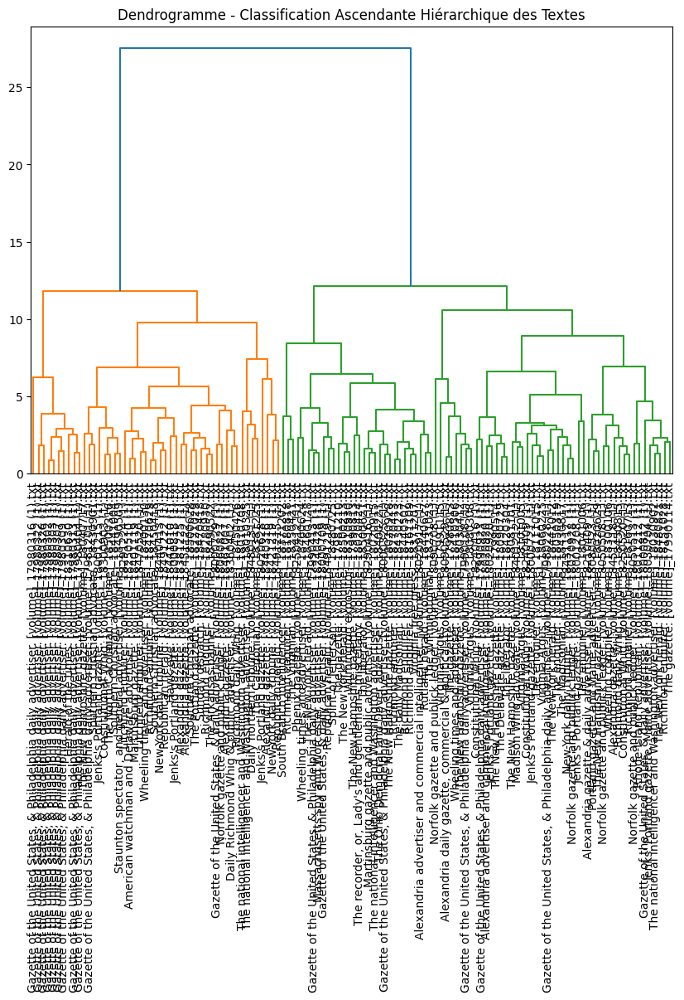

In [21]:
import pandas as pd
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler

# Extraire les fréquences émotionnelles des données
emotion_frequencies = [d['emotion frequencies'] for d in emotions_data]
df_emotions = pd.DataFrame(emotion_frequencies)

# Normaliser les données pour le clustering - c'est important car certaines émotions pourraient appraître avec une plus grande variabilité que d'autres
scaler = StandardScaler()
df_emotions_scaled = scaler.fit_transform(df_emotions)

# Appliquer le clustering hiérarchique
linkage_matrix = linkage(df_emotions_scaled, method='ward')  # Utilisation de la méthode de Ward

# Créer le dendrogramme
plt.figure(figsize=(10, 7))
dendrogram(
    linkage_matrix,
    labels=[os.path.basename(d['file']) for d in emotions_data],
    leaf_rotation=90,
    leaf_font_size=10
)
plt.title("Dendrogramme - Classification Ascendante Hiérarchique des Textes")
plt.show()


# Utiliser un modèle depuis Hugging Face

On peut explorer sur Hugging Face si des modèles pertinents pour les tâches que l'on souhaite réaliser n'ont pas déjà été entraînés. Voici un exemple de modèle issu d'un fine-tuning de CamemBERT (https://huggingface.co/botdevringring/fr-naxai-ai-emotion-classification-081808122023). Il est pensé pour des tweets, et n'admet en entrée que 512 tokens à la fois. Mais il est très performant... Rien n'empêche de le détourner de son usage...

In [ ]:
from transformers import pipeline

analyzer = pipeline(
    task='text-classification',
    model='botdevringring/fr-naxai-ai-emotion-classification-081808122023',
    tokenizer='botdevringring/fr-naxai-ai-emotion-classification-081808122023'
)
result = analyzer(
    "C'était à Mégara, faubourg de Carthage, dans les jardins d'Hamilcar. Les soldats qu'il avait commandés en Sicile se donnaient un grand festin pour célébrer le jour anniversaire de la bataille d'Eryx, et comme le maître était absent et qu'ils se trouvaient nombreux, ils mangeaient et ils buvaient en pleine liberté. Les capitaines, portant des cothurnes de bronze, s'étaient placés dans le chemin du milieu, sous un voile de pourpre à franges d'or, qui s'étendait depuis le mur des écuries jusqu'à la première terrasse du palais ; le commun des soldats était répandu sous les arbres, où l'on distinguait quantité de bâtiments à toit plat, pressoirs, celliers, magasins, boulangeries et arsenaux, avec une cour pour les éléphants, des fosses pour les bêtes féroces, une prison pour les esclaves."
)

result

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/1.03k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/272M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/1.59k [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/811k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.42M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/354 [00:00<?, ?B/s]

[{'label': 'joy', 'score': 0.6111332178115845}]

In [ ]:
import os
import glob
from transformers import pipeline, AutoTokenizer
import pandas as pd
import matplotlib.pyplot as plt

# Taille maximale du modèle (512 tokens - on se prend une mini marge d'erreur)
MAX_SEQUENCE_LENGTH = 500

# Initialisation du pipeline Hugging Face
analyzer = pipeline(
    task='text-classification',
    model='botdevringring/fr-naxai-ai-emotion-classification-081808122023',
    tokenizer='botdevringring/fr-naxai-ai-emotion-classification-081808122023'
)

# Initialisation du tokenizer pour découper le texte
tokenizer = AutoTokenizer.from_pretrained('botdevringring/fr-naxai-ai-emotion-classification-081808122023')

# Obtenir la liste des fichiers texte
text_dir = "/content/MonCorpusFr"  # Dossier contenant les fichiers texte
txt_files = glob.glob(os.path.join(text_dir, "*.txt"))

# Liste pour stocker les résultats des émotions
emotion_results = []

# Fonction pour diviser le texte en segments de taille maximale autorisée
def tokenize_text(text):
    # Tokenisation du texte
    tokens = tokenizer(text, return_tensors='pt', truncation=True, max_length=MAX_SEQUENCE_LENGTH)
    # Retourner les tokens encodés sous forme de segments
    return tokens['input_ids']

# Appliquer le modèle à chaque fichier texte
for txt_file in txt_files:
    with open(txt_file, 'r') as file:
        text = file.read()

    # Obtenir les tokens du texte
    token_segments = tokenize_text(text)

    # Analyser les segments sans dépasser la limite
    segment_results = []
    for token_segment in token_segments:
        # Convertir les tokens en texte
        segment_text = tokenizer.decode(token_segment, skip_special_tokens=True)

        # Analyser le segment avec le pipeline
        result = analyzer(segment_text)

        # Stocker les émotions obtenues
        segment_results.append({item['label']: item['score'] for item in result})

    # Obtenir la moyenne des résultats des segments
    df_segment = pd.DataFrame(segment_results)
    average_emotions = df_segment.mean().to_dict()

    # Ajouter les résultats pour le fichier texte
    emotion_results.append({
        "file": os.path.basename(txt_file),
        "emotions": average_emotions
    })

# Créer un DataFrame avec les résultats
df_emotions = pd.DataFrame(emotion_results)

# Afficher les résultats
print(df_emotions)

## Avec toutes les émotions

In [ ]:
import os
import glob
from transformers import pipeline, AutoTokenizer
import pandas as pd
import matplotlib.pyplot as plt

# Define the maximum model sequence length (512 tokens)
MAX_SEQUENCE_LENGTH = 500

# Initialize the Hugging Face pipeline
analyzer = pipeline(
    task='text-classification',
    model='botdevringring/fr-naxai-ai-emotion-classification-081808122023',
    return_all_scores=True,  # Ensure all scores are returned
)

# Initialize the tokenizer to split the text
tokenizer = AutoTokenizer.from_pretrained('botdevringring/fr-naxai-ai-emotion-classification-081808122023')

# Get the list of text files
text_dir = "/content/MonCorpusFr"  # Folder containing text files
txt_files = glob.glob(os.path.join(text_dir, "*.txt"))

# Function to split text into segments of 512 tokens or less
def tokenize_text(text):
    # Tokenize the text with truncation to ensure the limit is not exceeded
    tokens = tokenizer(text, return_tensors='pt', truncation=True, max_length=MAX_SEQUENCE_LENGTH)
    return tokens['input_ids']

# List to store emotion results
emotion_results = []

# Apply the model to each text file
for txt_file in txt_files:
    with open(txt_file, 'r') as file:
        text = file.read()

    # Get the token segments for the text
    token_segments = tokenize_text(text)

    # Collect emotion results for each segment
    segment_results = []
    for token_segment in token_segments:
        # Convert the token segment back to text
        segment_text = tokenizer.decode(token_segment, skip_special_tokens=True)

        # Analyze the segment with the pipeline
        results = analyzer(segment_text)

        # Collect the emotions from the results
        # results is a list of dictionaries with labels and scores
        emotions = {item['label']: item['score'] for sublist in results for item in sublist}

        segment_results.append(emotions)

    # Compute the average emotion scores across all segments for this text
    df_segment = pd.DataFrame(segment_results)
    average_emotions = df_segment.mean().to_dict()

    # Add the results for the current text file
    emotion_results.append({
        "file": os.path.basename(txt_file),
        "emotions": average_emotions
    })

# Create a DataFrame with the emotion results
df_emotions = pd.DataFrame(emotion_results)

# Display the emotion scores for each text
print(df_emotions)

# Visualize all emotions for each text
for idx, row in df_emotions.iterrows():
    plt.figure(figsize=(10, 6))
    plt.bar(row['emotions'].keys(), row['emotions'].values())
    plt.xlabel('Emotions')
    plt.ylabel('Scores')
    plt.title(f"Emotion Analysis - {row['file']}")
    plt.show()


### Analyse roulante

Pas adaptée avec ce modèle en cas d'analyse de trop grands textes (le graphique sera, comme dans mon exemple, relativement difficile à lire). Mais il peut servir pour certains de vos corpus.

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


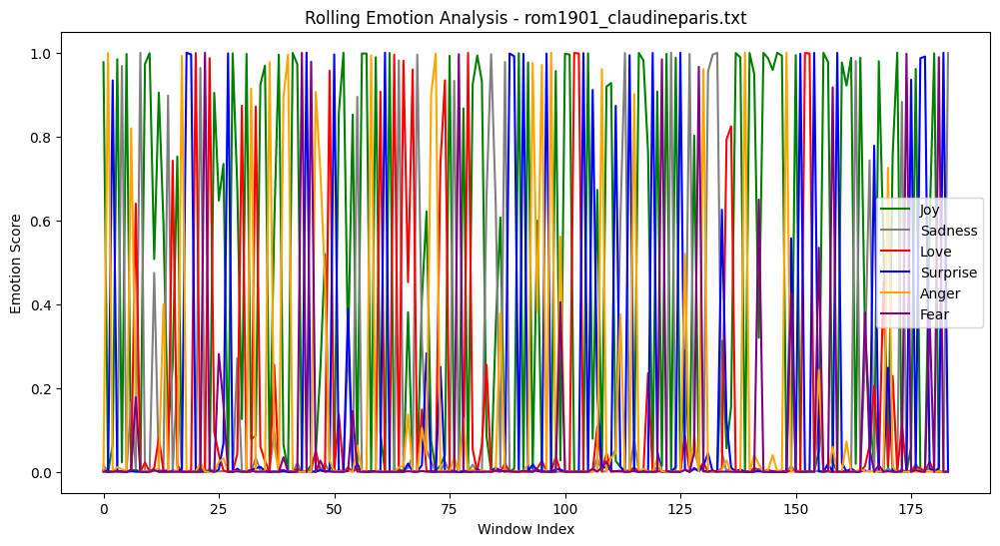

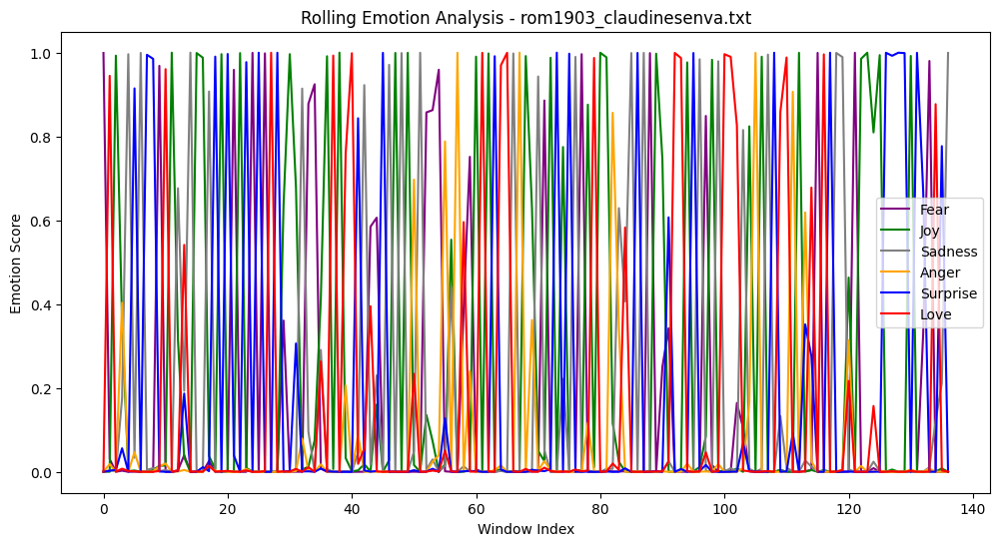

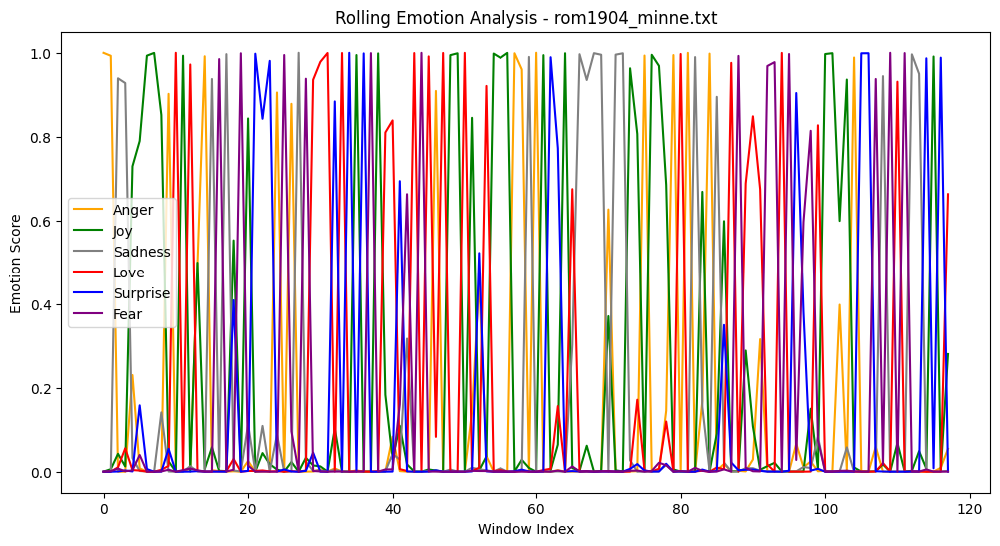

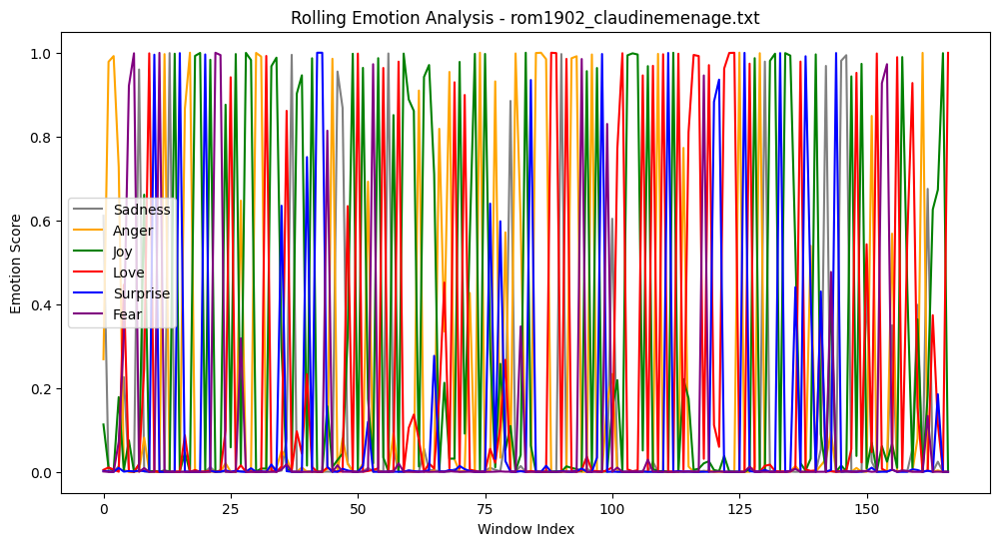

In [ ]:
import os
import glob
import pandas as pd
from transformers import pipeline, AutoTokenizer
import matplotlib.pyplot as plt

emotion_colors = {
    'fear': 'purple',
    'anger': 'orange',
    'surprise': 'blue',
    'sadness': 'gray',
    'joy': 'green',
    'love': 'red'
}

# On définit notre pipeline, avec le modèle importé d'Hugging Face
analyzer = pipeline(
    task='text-classification',
    model='botdevringring/fr-naxai-ai-emotion-classification-081808122023',
    top_k=None ,  # Return all emotion scores
    device=0 #To work with a GPU
)

# On tokenise
tokenizer = AutoTokenizer.from_pretrained('botdevringring/fr-naxai-ai-emotion-classification-081808122023')

# Définition du dossier où se trouve notre corpus
text_dir = "/content/MonCorpusFr"
txt_files = glob.glob(os.path.join(text_dir, "*.txt"))

# Définition de la taille de la fenêtre roulante (250 tokens) et du recouvrement (aucun ici)
window_size = 300
step_size = window_size

# Function to create rolling windows based on word counts
def create_rolling_windows(text, window_size, step_size):
    words = text.split()  # Split the text into words
    # Create windows based on word counts
    windows = [" ".join(words[i:i + window_size]) for i in range(0, len(words), step_size)]
    return windows

# Analyze each text file with a rolling window approach
emotion_results = []
for txt_file in txt_files:
    with open(txt_file, 'r') as file:
        text = file.read()

    # Create rolling windows based on word counts
    rolling_windows = create_rolling_windows(text, window_size, step_size)

    # Store the emotion results for each window
    emotion_data = []
    for segment in rolling_windows:
        # Analyze the segment with the Hugging Face pipeline
        results = analyzer(segment)

        # Convert the results to a dictionary of emotion scores
        emotions = {item['label']: item['score'] for sublist in results for item in sublist}

        emotion_data.append(emotions)

    # Add the results for the current text file
    emotion_results.append({
        "file": os.path.basename(txt_file),
        "emotions": emotion_data  # Store all emotion results for the rolling analysis
    })

# Visualize the rolling analysis for each text
for result in emotion_results:
    # Create a DataFrame from the emotion data
    df_emotion = pd.DataFrame(result['emotions'])

    # Plot each emotion over the rolling windows
    plt.figure(figsize=(12, 6))
    for emotion in df_emotion.columns:
        plt.plot(df_emotion.index, df_emotion[emotion], label=emotion.capitalize(), color=emotion_colors.get(emotion, 'black'))

    plt.xlabel('Window Index')
    plt.ylabel('Emotion Score')
    plt.title(f"Rolling Emotion Analysis - {result['file']}")
    plt.legend()
    plt.show()


En cas de textes plus long, on peut simplement travailler sur la moyenne des émotions mesurées au cours de passages d'une longueur arbitraire.

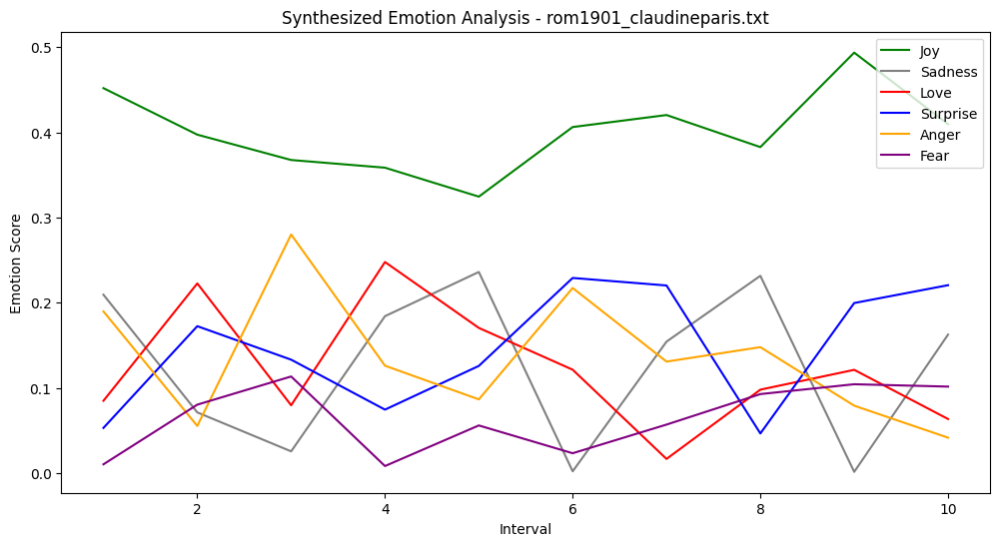

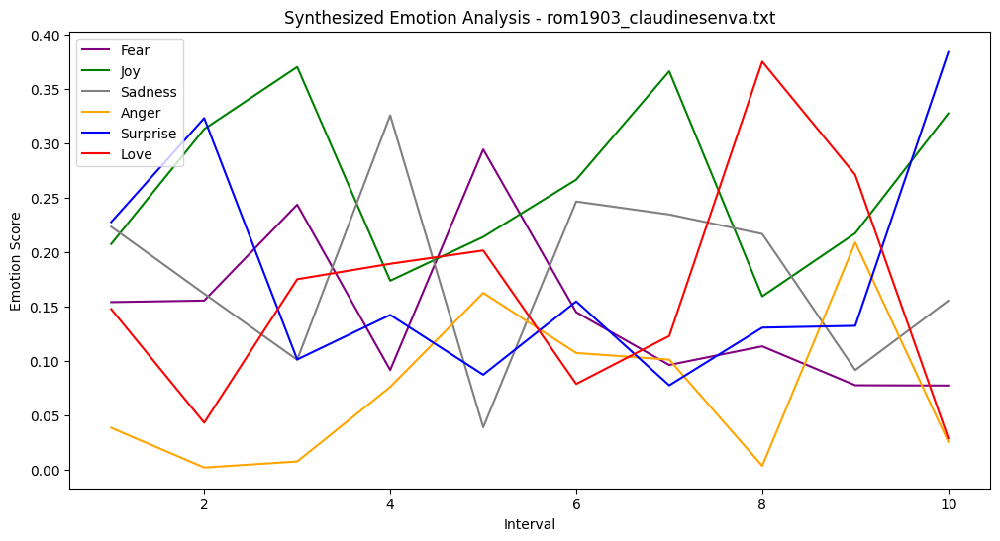

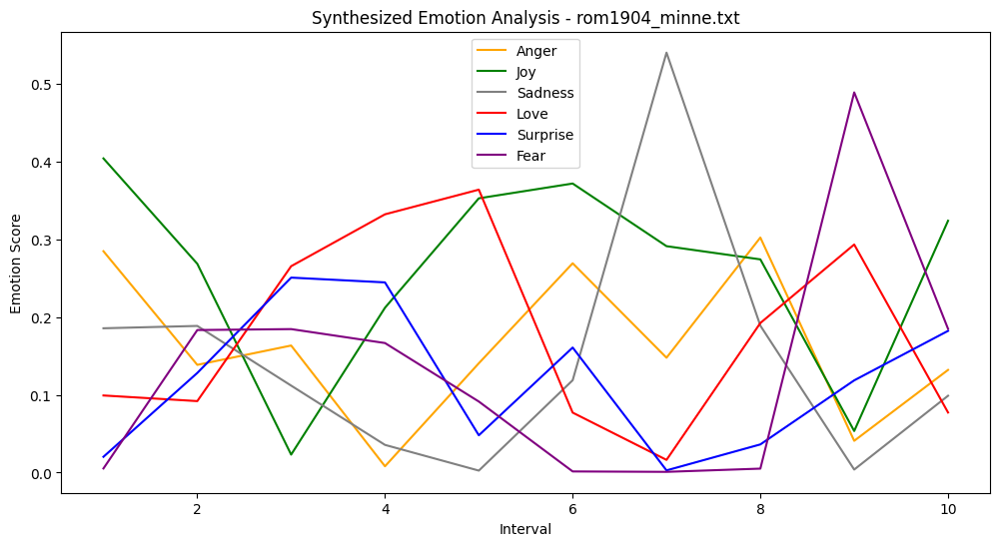

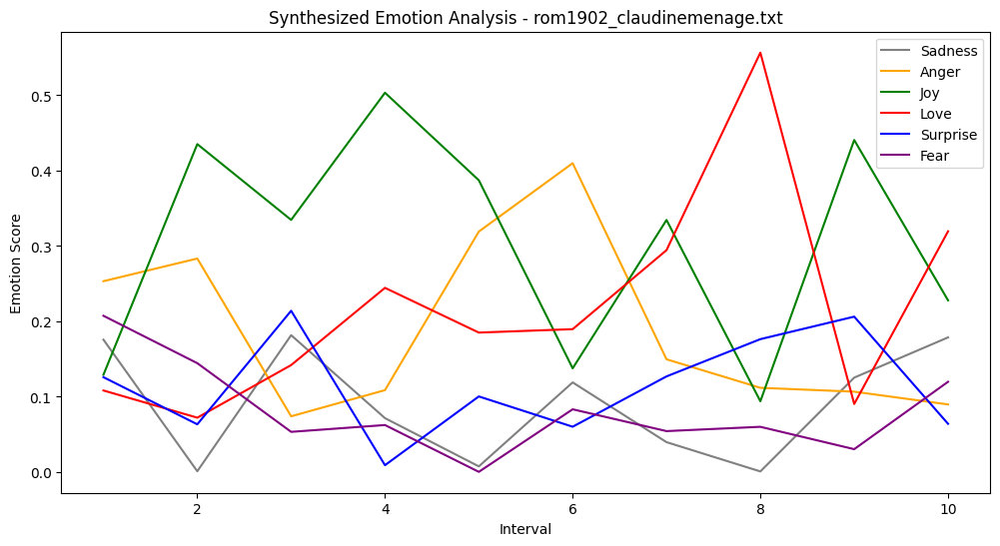

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# On définit une palette de couleurs

emotion_colors = {
    'fear': 'purple',
    'anger': 'orange',
    'surprise': 'blue',
    'sadness': 'gray',
    'joy': 'green',
    'love': 'red'
}

# On veut diviser les textes en un nombre de parties arbitraires (ici: 10)
num_segments = 10

# On se prépare à agréger les résultats
synthesized_results = []

#On itére sur les résultats
for result in emotion_results:
    # DataFrame des résultats de l'analyse roulante
    df_emotion = pd.DataFrame(result['emotions'])

    # On détermine la taille des intervalles
    interval_size = len(df_emotion) // num_segments

    # Liste pour stocker les émotions moyennes pour chaque intervalle
    interval_averages = []

    # Calcul des émotions moyennes pour chaque intervalle
    for i in range(num_segments):
        # Début et fin des intervalles
        start_idx = i * interval_size
        end_idx = start_idx + interval_size

        # Découpage du DataFrame
        interval_df = df_emotion.iloc[start_idx:end_idx]

        # Calcul de la moyenne des émotions
        mean_emotions = interval_df.mean().to_dict()

        interval_averages.append(mean_emotions)

    # Ajout des résultats synthétisés
    synthesized_results.append({
        "file": result['file'],
        "averages": interval_averages
    })

# Visualisation des résultats synthéthisés pour chaque texte
for synthesized_result in synthesized_results:
    # Creation d'une dataframe
    df_interval = pd.DataFrame(synthesized_result['averages'])

    # On crée les graphes
    plt.figure(figsize=(12, 6))
    for emotion in df_interval.columns:
        plt.plot(range(1, num_segments + 1), df_interval[emotion], label=emotion.capitalize(), color=emotion_colors.get(emotion, 'black'))

    plt.xlabel('Interval')
    plt.ylabel('Emotion Score')
    plt.title(f"Synthesized Emotion Analysis - {synthesized_result['file']}")
    plt.legend()
    plt.show()
